In [1]:
import nltk
import random
from nltk.classify.scikitlearn import SklearnClassifier
import pickle
from sklearn.naive_bayes import MultinomialNB, BernoulliNB
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.svm import SVC
from nltk.classify import ClassifierI
from statistics import mode
from nltk.tokenize import word_tokenize
import re
import os
import time
import matplotlib.pyplot as plt

In [3]:
# read positive and negative training data
files_pos = os.listdir('train/pos')
files_pos = [open("train/pos/"+f, "r", encoding="utf-8").read() for f in files_pos]
files_neg = os.listdir('train/neg')
files_neg = [open("train/neg/"+f, "r", encoding="utf-8").read() for f in files_neg]

In [4]:
# data preprocessing
all_words = []
documents = []

from nltk.corpus import stopwords
stop_words = list(set(stopwords.words('english')))

#  j is adject, r is adverb, and v is verb
#allowed_word_types = ["J","R","V"]
allowed_word_types = ["J"]

In [5]:
# create a list of tuples where the first element of each tuple is a review
# the second element is the label
for p in files_pos:
    documents.append( (p, "pos") )

    # remove punctuations
    cleaned = re.sub(r'[^(a-zA-Z)\s]','', p)

    # tokenize 
    tokenized = word_tokenize(cleaned)

    # remove stopwords 
    stopped = [w for w in tokenized if not w in stop_words]

    # parts of speech tagging for each word 
    pos = nltk.pos_tag(stopped)

    # make a list of  all adjectives identified by the allowed word types list above
    for w in pos:
        if w[1][0] in allowed_word_types:
            all_words.append(w[0].lower())

In [6]:
# create a list of tuples where the first element of each tuple is a review
# the second element is the label
for p in files_neg:
    documents.append( (p, "neg") )

    # remove punctuations
    cleaned = re.sub(r'[^(a-zA-Z)\s]','', p)

    # tokenize 
    tokenized = word_tokenize(cleaned)

    # remove stopwords 
    stopped = [w for w in tokenized if not w in stop_words]

    # parts of speech tagging for each word 
    neg = nltk.pos_tag(stopped)

    # make a list of  all adjectives identified by the allowed word types list above
    for w in neg:
        if w[1][0] in allowed_word_types:
            all_words.append(w[0].lower())

In [7]:
pos_A = []
for w in pos:
    if w[1][0] in allowed_word_types:
        pos_A.append(w[0].lower())
pos_N = []
for w in neg:
    if w[1][0] in allowed_word_types:
        pos_N.append(w[0].lower())

In [8]:
from wordcloud import WordCloud
text = ' '.join(pos_A)
wordcloud = WordCloud(width=1920, height=1080, background_color="white").generate(text)

# Save the generated image:
wordcloud.to_file("img/mostFrequentPositive.png")

text_neg = ' '.join(pos_N)
wordcloud = WordCloud(width=1920, height=1080, background_color="white", colormap="Reds").generate(text_neg)
wordcloud.to_file("img/mostFrequentNegative.png")

In [ ]:
plt.figure(figsize = (15, 9))
# Display the generated image:
plt.imshow(wordcloud, interpolation= "bilinear")
plt.axis("off")
plt.show()

In [9]:
# pickling the list documents to save future recalculations 
save_documents = open("pickled_algos/documents.pickle","wb")
pickle.dump(documents, save_documents)
save_documents.close()

In [10]:
# creating a frequency distribution of each adjectives. 
BOW = nltk.FreqDist(all_words)

# listing the 5000 most frequent words
print("BOW: ",len(BOW.keys()))
word_features = list(BOW.keys())[:5000]
print(len(word_features))

save_word_features = open("pickled_algos/word_features5k.pickle","wb")
pickle.dump(word_features, save_word_features)
save_word_features.close()

BOW:  9348
5000


In [11]:
# function to create a dictionary of features for each review in the list document.
# The keys are the words in word_features 
# The values of each key are either true or false for wether that feature appears in the review or not
def find_features(document):
    words = word_tokenize(document)
    features = {}
    for w in word_features:
        features[w] = (w in words)

    return features

# Creating features for each review
featuresets = [(find_features(rev), category) for (rev, category) in documents]

In [27]:
featuresets

[({'nonenglish': False,
   'major': False,
   'good': True,
   'extra': False,
   'learn': True,
   'interesting': True,
   'main': False,
   'valuable': False,
   'listen': False,
   'contexts': False,
   'read': False,
   'different': True,
   'lasting': False,
   'helpful': True,
   'nervous': False,
   'texts': False,
   'ideas': False,
   'real': False,
   'nonanglo': False,
   'write': False,
   'insight': False,
   'reading': False,
   'honest': False,
   'foreign': False,
   'familiar': False,
   'close': False,
   'favorite': False,
   'brilliant': False,
   'able': True,
   'english': False,
   'meaningful': False,
   'greater': False,
   'societal': False,
   'practical': False,
   'easy': False,
   'difficult': True,
   'dont': False,
   'attentive': False,
   'hard': True,
   'prof': False,
   'great': False,
   'insightful': False,
   'overall': False,
   'better': True,
   'understand': True,
   'beautiful': False,
   'quick': False,
   'ignorant': False,
   'huge': True

In [12]:
# Shuffling the documents 
random.shuffle(featuresets)
print(len(featuresets))

training_set = featuresets[:700]
testing_set = featuresets[700:]
print( 'training_set :', len(training_set), '\ntesting_set :', len(testing_set))

1084
training_set : 700 
testing_set : 384


In [30]:
training_set[0]

({'nonenglish': False,
  'major': False,
  'good': True,
  'extra': False,
  'learn': True,
  'interesting': True,
  'main': False,
  'valuable': False,
  'listen': False,
  'contexts': False,
  'read': False,
  'different': True,
  'lasting': False,
  'helpful': True,
  'nervous': False,
  'texts': False,
  'ideas': False,
  'real': False,
  'nonanglo': False,
  'write': False,
  'insight': False,
  'reading': False,
  'honest': False,
  'foreign': False,
  'familiar': False,
  'close': False,
  'favorite': False,
  'brilliant': False,
  'able': True,
  'english': False,
  'meaningful': False,
  'greater': False,
  'societal': False,
  'practical': False,
  'easy': False,
  'difficult': True,
  'dont': False,
  'attentive': False,
  'hard': True,
  'prof': False,
  'great': False,
  'insightful': False,
  'overall': False,
  'better': True,
  'understand': True,
  'beautiful': False,
  'quick': False,
  'ignorant': False,
  'huge': True,
  'redundant': False,
  'lengthy': False,
  'en

In [13]:
classifier = nltk.NaiveBayesClassifier.train(training_set)
print("Classifier accuracy percent:",(nltk.classify.accuracy(classifier, testing_set))*100)
classifier.show_most_informative_features(15)

Classifier accuracy percent: 71.61458333333334
Most Informative Features
                      be = False             pos : neg    =     38.6 : 1.0
                   fewer = True              neg : pos    =     23.3 : 1.0
          unprofessional = True              neg : pos    =     22.6 : 1.0
              frustrated = True              neg : pos    =     21.2 : 1.0
                    more = False             pos : neg    =     19.6 : 1.0
            inconsistent = True              neg : pos    =     18.4 : 1.0
                  timing = True              neg : pos    =     17.9 : 1.0
                 shorter = True              neg : pos    =     16.5 : 1.0
                  upload = True              neg : pos    =     16.4 : 1.0
                   nicer = True              neg : pos    =     15.8 : 1.0
                    dark = True              neg : pos    =     15.2 : 1.0
                   worse = True              neg : pos    =     14.6 : 1.0
                  nobody = 

In [14]:
# Printing the most important features 
mif = classifier.most_informative_features()
mif = [a for a,b in mif]
print(mif)

['be', 'fewer', 'unprofessional', 'frustrated', 'more', 'inconsistent', 'timing', 'shorter', 'upload', 'nicer', 'dark', 'worse', 'nobody', 'slower', 'rid', 'ex', 'dedicate', 'absent', 'disrespectful', 'disappointing', 'preferred', 'frame', 'laptop', 'subjective', 'faster', 'ambiguous', 'willingness', 'humorous', 'odd', 'afford', 'allotted', 'arrive', 'specified', 'weigh', 'bulk', 'coordinate', 'irritating', 'cruel', 'thoughtful', 'send', 'mid', 'tangent', 'harshly', 'disruptive', 'switched', 'outrageous', 'unbearable', 'phenomenal', 'disorganized', 'update', 'impressed', 'opens', 'inefficient', 'appreciation', 'document', 'verbal', 'monotone', 'arent', 'sub', 'ten', 'slightest', 'incoherent', 'problematic', 'blue', 'shaped', 'cut', 'annoyed', 'frustrating', 'unacceptable', 'rubric', 'refreshing', 'grammatical', 'chaotic', 'weak', 'handful', 'influenced', 'array', 'twice', 'mic', 'specify', 'drawn', 'unfair', 'vague', 'atrocious', 'vary', 'penalize', 'conflicted', 'red', 'lesser', 'sudd

In [15]:
# getting predictions for the testing set by looping over each reviews featureset tuple
# The first elemnt of the tuple is the feature set and the second element is the label 
ground_truth = [r[1] for r in testing_set]
preds = [classifier.classify(r[0]) for r in testing_set]

In [22]:
from sklearn.metrics import f1_score, accuracy_score
f1_score(ground_truth, preds, labels = ['neg', 'pos'], average = 'micro')

0.7161458333333334

Confusion matrix, without normalization
[[111  83]
 [ 26 164]]
Normalized confusion matrix
[[0.57 0.43]
 [0.14 0.86]]


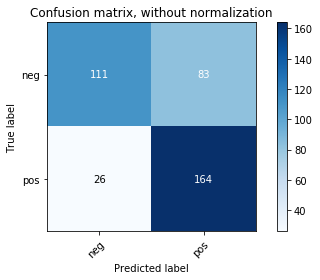

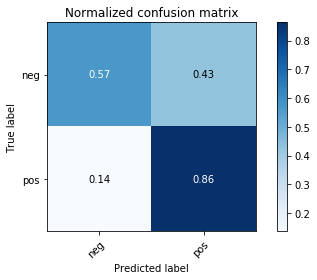

In [17]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn import svm, datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels

y_test = ground_truth
y_pred = preds
class_names = ['neg', 'pos']



def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax


np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plot_confusion_matrix(y_test, y_pred, classes=class_names,
                      title='Confusion matrix, without normalization')

# Plot normalized confusion matrix
plot_confusion_matrix(y_test, y_pred, classes=class_names, normalize=True,
                      title='Normalized confusion matrix')

plt.show()

In [18]:
from nltk.classify.scikitlearn import SklearnClassifier
from sklearn.naive_bayes import MultinomialNB,BernoulliNB
from sklearn.linear_model import LogisticRegression,SGDClassifier
from sklearn.svm import SVC

Classifiers for an ensemble model: 
Naive Bayes (NB)
Multinomial NB
Bernoulli NB
Logistic Regression
Stochastic Gradient Descent Classifier - SGD
Support Vector Classification - SVC

In [19]:
print("Original Naive Bayes Algo accuracy percent:", (nltk.classify.accuracy(classifier, testing_set))*100)
classifier.show_most_informative_features(15)

MNB_clf = SklearnClassifier(MultinomialNB())
MNB_clf.train(training_set)
print("MNB_classifier accuracy percent:", (nltk.classify.accuracy(MNB_clf, testing_set))*100)

BNB_clf = SklearnClassifier(BernoulliNB())
BNB_clf.train(training_set)
print("BernoulliNB_classifier accuracy percent:", (nltk.classify.accuracy(BNB_clf, testing_set))*100)

LogReg_clf = SklearnClassifier(LogisticRegression())
LogReg_clf.train(training_set)
print("LogisticRegression_classifier accuracy percent:", (nltk.classify.accuracy(LogReg_clf, testing_set))*100)

SGD_clf = SklearnClassifier(SGDClassifier())
SGD_clf.train(training_set)
print("SGDClassifier_classifier accuracy percent:", (nltk.classify.accuracy(SGD_clf, testing_set))*100)

SVC_clf = SklearnClassifier(SVC())
SVC_clf.train(training_set)
print("SVC_classifier accuracy percent:", (nltk.classify.accuracy(SVC_clf, testing_set))*100)

Original Naive Bayes Algo accuracy percent: 71.61458333333334
Most Informative Features
                      be = False             pos : neg    =     38.6 : 1.0
                   fewer = True              neg : pos    =     23.3 : 1.0
          unprofessional = True              neg : pos    =     22.6 : 1.0
              frustrated = True              neg : pos    =     21.2 : 1.0
                    more = False             pos : neg    =     19.6 : 1.0
            inconsistent = True              neg : pos    =     18.4 : 1.0
                  timing = True              neg : pos    =     17.9 : 1.0
                 shorter = True              neg : pos    =     16.5 : 1.0
                  upload = True              neg : pos    =     16.4 : 1.0
                   nicer = True              neg : pos    =     15.8 : 1.0
                    dark = True              neg : pos    =     15.2 : 1.0
                   worse = True              neg : pos    =     14.6 : 1.0
            

C:\Users\pulki\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


LogisticRegression_classifier accuracy percent: 99.73958333333334
SGDClassifier_classifier accuracy percent: 98.95833333333334


C:\Users\pulki\Anaconda3\lib\site-packages\sklearn\svm\base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)


SVC_classifier accuracy percent: 86.19791666666666


In [20]:
def create_pickle(c, file_name): 
    save_classifier = open(file_name, 'wb')
    pickle.dump(c, save_classifier)
    save_classifier.close()

classifiers_dict = {'ONB': [classifier, 'pickled_algos/ONB_clf.pickle'],
                    'MNB': [MNB_clf, 'pickled_algos/MNB_clf.pickle'],
                    'BNB': [BNB_clf, 'pickled_algos/BNB_clf.pickle'],
                    'LogReg': [LogReg_clf, 'pickled_algos/LogReg_clf.pickle'],
                    'SGD': [SGD_clf, 'pickled_algos/SGD_clf.pickle'], 
                    'SVC': [SVC_clf, 'pickled_algos/SVC_clf.pickle']}




for clf, listy in classifiers_dict.items(): 
    create_pickle(listy[0], listy[1])

# Ensemble Model

In [24]:
from nltk.classify import ClassifierI

# Defininig the ensemble model class 

class EnsembleClassifier(ClassifierI):
    
    def __init__(self, *classifiers):
        self._classifiers = classifiers
    
    # returns the classification based on majority of votes
    def classify(self, features):
        votes = []
        for c in self._classifiers:
            v = c.classify(features)
            votes.append(v)
        return mode(votes)
    # a simple measurement the degree of confidence in the classification 
    def confidence(self, features):
        votes = []
        for c in self._classifiers:
            v = c.classify(features)
            votes.append(v)

        choice_votes = votes.count(mode(votes))
        conf = choice_votes / len(votes)
        return conf

In [25]:
# Load all classifiers from the pickled files 

# function to load models given filepath
def load_model(file_path): 
    classifier_f = open(file_path, "rb")
    classifier = pickle.load(classifier_f)
    classifier_f.close()
    return classifier


# Original Naive Bayes Classifier
ONB_Clf = load_model('pickled_algos/ONB_clf.pickle')

# Multinomial Naive Bayes Classifier 
MNB_Clf = load_model('pickled_algos/MNB_clf.pickle')


# Bernoulli  Naive Bayes Classifier 
BNB_Clf = load_model('pickled_algos/BNB_clf.pickle')

# Logistic Regression Classifier 
LogReg_Clf = load_model('pickled_algos/LogReg_clf.pickle')

# Stochastic Gradient Descent Classifier
SGD_Clf = load_model('pickled_algos/SGD_clf.pickle')



# Initializing the ensemble classifier 
ensemble_clf = EnsembleClassifier(ONB_Clf, MNB_Clf, BNB_Clf, LogReg_Clf, SGD_Clf)

# List of only feature dictionary from the featureset list of tuples 
feature_list = [f[0] for f in testing_set]

# Looping over each to classify each review
ensemble_preds = [ensemble_clf.classify(features) for features in feature_list]

In [26]:
f1_score(ground_truth, ensemble_preds, average = 'micro')

0.9609375